# EXPLAINABLE AI

Mounting the drive to get access to the pretrained mobilenet model and dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **LIME Method** 

#### INSTALLING Libraries
- PaddlePaddle and InterpretDL has inbulilt method for LIME which is modified to adapt to and apply to our model


In [ ]:
pip install interpretdl

     |████████████████████████████████| 83 kB 1.4 MB/s 
     |████████████████████████████████| 22.3 MB 2.8 MB/s 
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.0.2
    Uninstalling scikit-learn-1.0.2:
      Successfully uninstalled scikit-learn-1.0.2


In [ ]:
pip install paddlepaddle


     |████████████████████████████████| 108.4 MB 24 kB/s 


#### IMPORTING LIBRARIES

In [ ]:
import paddle
import interpretdl as it

/usr/local/lib/python3.7/dist-packages/yaml/constructor.py:126: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  if not isinstance(key, collections.Hashable):


Load pretrained model for mobilenet v1

In [ ]:
from paddle.vision.models import mobilenet_v1
paddle_model = mobilenet_v1(pretrained=True)

100%|██████████| 25072/25072 [00:39<00:00, 639.78it/s]


### **LIME method**
- An object of LIMECVInterpreter is created to which our pretrained model is passed and it will make use of the CUDA's GPU support


In [ ]:
lime = it.LIMECVInterpreter(paddle_model, use_cuda=True)

/usr/local/lib/python3.7/dist-packages/interpretdl/interpreter/abc_interpreter.py:221: UserWarning: ``use_cuda`` would be deprecated soon. Use ``device`` directly.
  Interpreter.__init__(self, paddle_model, device, use_cuda, **kwargs)


Loading the sample test image 

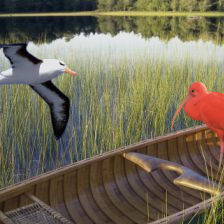

In [ ]:
from PIL import Image
from interpretdl.data_processor.readers import read_image

img_path = '/content/drive/MyDrive/Multisplicing/train/Sp_D_ani_00064_ani_00058_art_00033_214.png'
x = Image.fromarray(read_image(img_path)[0])
x

#####  GETTING THE OUTPUT BY PASSING THE IMAGE AND PARAMETERS OF BATCH AND NO OF SAMPLING TO BE DONE IN LIME TO THE INTERPRETER OBJECT.


> Parameters

1.  img path: path to the image
2.  num samples: no of times sampling to be done
2.   batch size: size of the batch
3.   visual: Display the output image
4.   save_path: path to save the output






Paddle is not installed with GPU support. Change to CPU version now.


100%|██████████| 2000/2000 [05:01<00:00,  6.62it/s]
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  


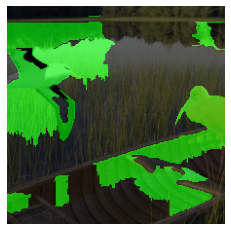

In [ ]:
lime_weights = lime.interpret(
    img_path,
    num_samples=2000,
    batch_size=50,
    visual=True,
    save_path=None
)

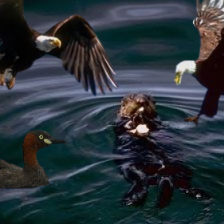

In [ ]:
img_path = '/content/drive/MyDrive/Multisplicing/train/Sp_D_ani_30485_ani_30115_ani_30197_ani_20068_29.png'
x = Image.fromarray(read_image(img_path)[0])
x

100%|██████████| 3000/3000 [07:39<00:00,  6.53it/s]
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  


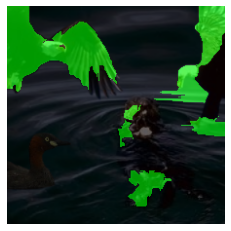

In [ ]:
lime_weights = lime.interpret(
    img_path,
    num_samples=3000,
    batch_size=50,
    visual=True,
    save_path=None
)

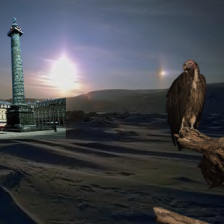

In [ ]:
img_path='/content/drive/MyDrive/Multisplicing/train/Sp_D_arc_00030_nat_00054_ani_00074_129.png'
x = Image.fromarray(read_image(img_path)[0])
x

100%|██████████| 5000/5000 [12:38<00:00,  6.59it/s]


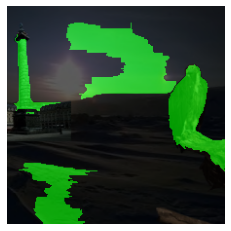

In [ ]:
lime_weights = lime.interpret(
    img_path,
    num_samples=5000,
    batch_size=50,
    visual=True,
    save_path=None
)

## GradCAM, GradCAM++, EigenCAM, AblationCAM


In [ ]:
pip install ttach

#### Cloning the repository from github

In [ ]:
!git clone https://github.com/kenypatel233/pytorch-grad-cam.git

Cloning into 'pytorch-grad-cam'...
remote: Enumerating objects: 755, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 755 (delta 15), reused 31 (delta 8), pack-reused 702
Receiving objects: 100% (755/755), 3.68 MiB | 17.22 MiB/s, done.
Resolving deltas: 100% (394/394), done.


In [ ]:
cd /content/pytorch-grad-cam

/content/pytorch-grad-cam


In [ ]:
import torch
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM,LayerCAM
from pytorch_grad_cam.utils.find_layers import find_layer_types_recursive

In [ ]:
from pytorch_grad_cam.utils.image import show_cam_on_image,preprocess_image, deprocess_image

#### Load our pretrained model



In [ ]:
the_model = torch.load("/content/drive/MyDrive/Multisplicing/mobilenet_v1")

#### Find all target layers of specified type to generate CAM output on.


> Parameters
1. model: model for which layers are to be found
2. layer type: type of layer to be found in the model



In [ ]:
target_layers = find_layer_types_recursive(the_model, [torch.nn.Conv2d])

In [ ]:
target_layers[0]

Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)

In [ ]:
len(target_layers)

52

#### Target class wrt to which activations are to be generated
- In our case, we have only one class. Hence, we specify none.

In [ ]:
targets = None

#### Method of CAM to be used

In [ ]:
 methods ={"gradcam": GradCAM,
         "scorecam": ScoreCAM,
         "gradcam++": GradCAMPlusPlus,
         "ablationcam": AblationCAM,
         "eigencam": EigenCAM,
         "layercam": LayerCAM
         
 }

#### Load and preprocess our sample image

In [ ]:
rgb_img = cv2.imread('/content/drive/MyDrive/Multisplicing/train/Sp_D_ani_00064_ani_00058_art_00033_214.png', 1)[:, :, ::-1]
rgb_img = np.float32(rgb_img) / 255
input_tensor = preprocess_image(rgb_img,
                                    mean=[0.485, 0.456, 0.406],
                                    std=[0.229, 0.224, 0.225])

### For each type of method
- Initialize an object of the method required


> Parameters
1. model: model to perform the task on
2. target layers: layer in the model where heatmap is to be generated

- Pass the input image tensor and target class to the method which generates a grayscale heatmap
- Overlay the grayscale heatmap on the image and convert it to rgb


####  For each specified type of layer in the model, we repeat the above process 

### GRAD CAM OUTPUT

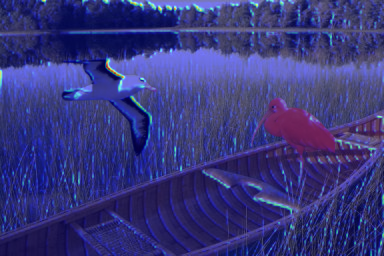

[Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)]




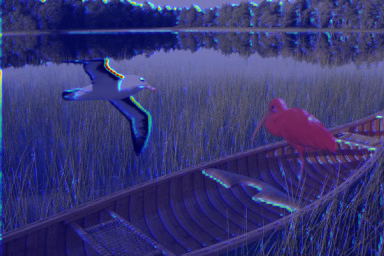

[Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)]




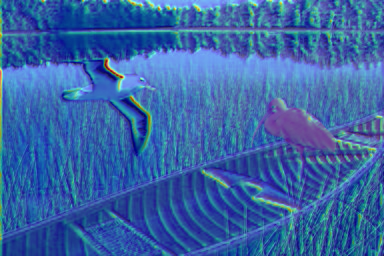

[Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)]




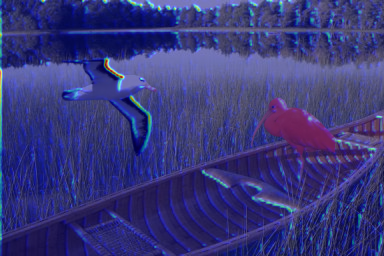

[Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




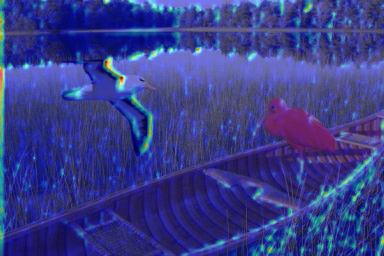

[Conv2d(96, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=96, bias=False)]




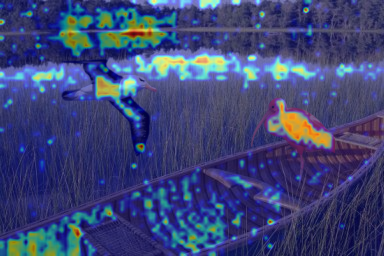

[Conv2d(96, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




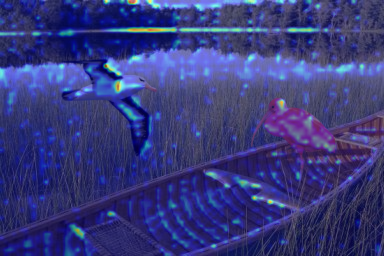

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




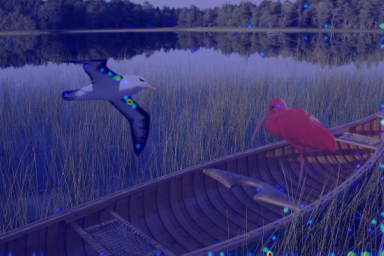

[Conv2d(144, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=144, bias=False)]




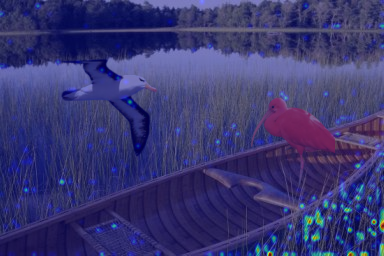

[Conv2d(144, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




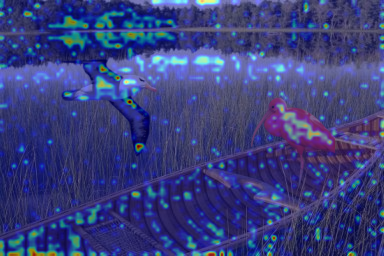

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




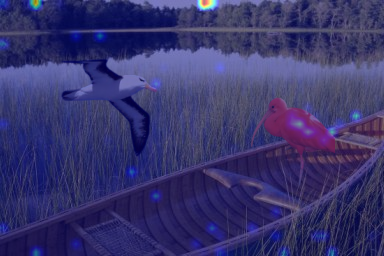

[Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=144, bias=False)]




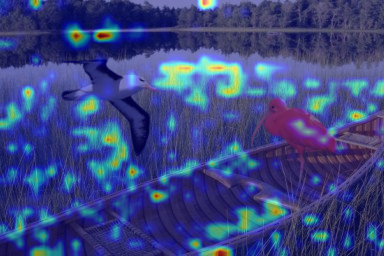

[Conv2d(144, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




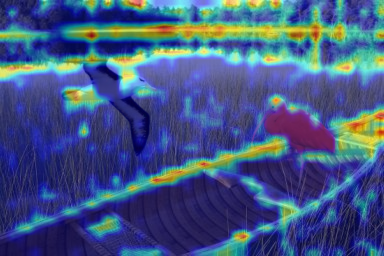

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




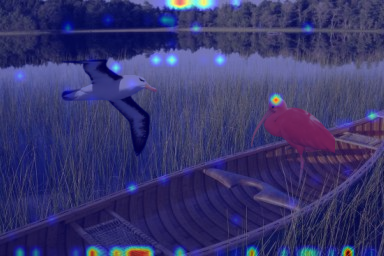

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




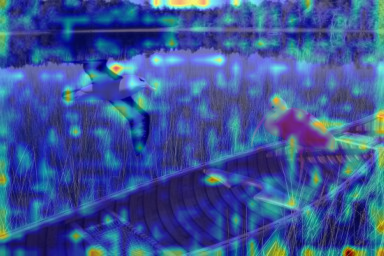

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




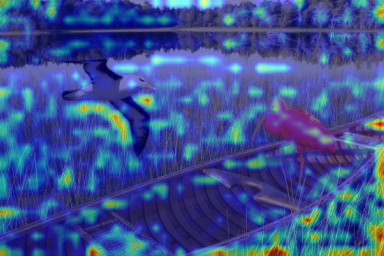

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




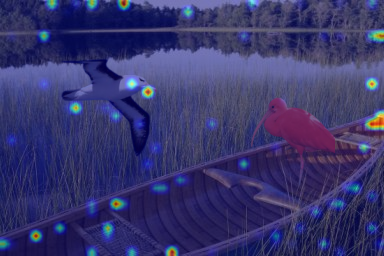

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




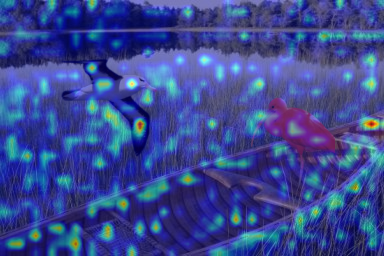

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




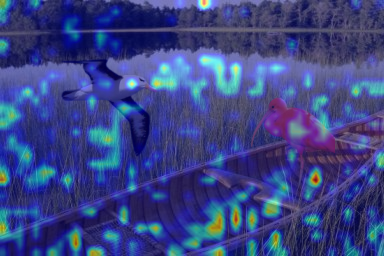

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




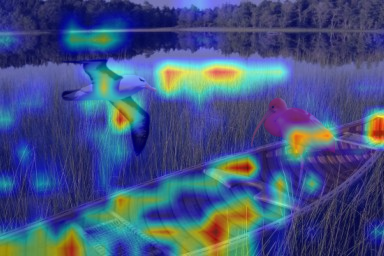

[Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=192, bias=False)]




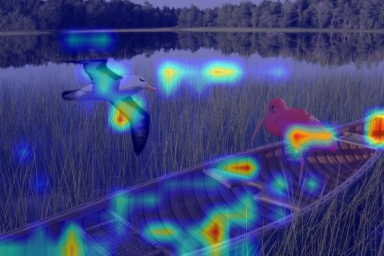

[Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




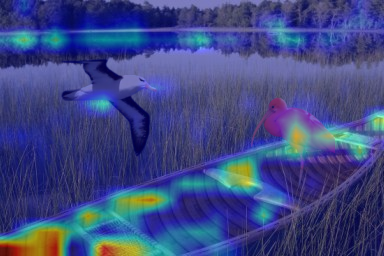

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




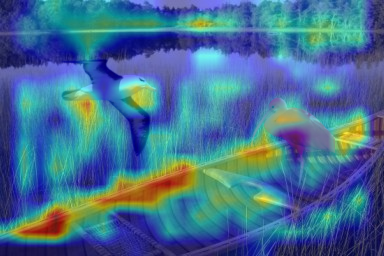

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




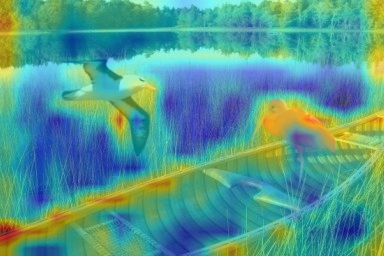

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




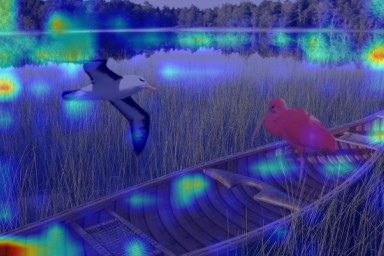

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




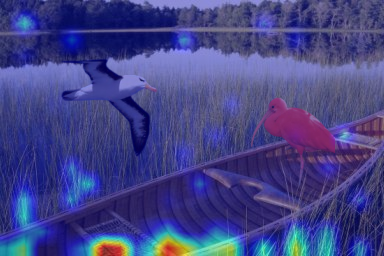

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




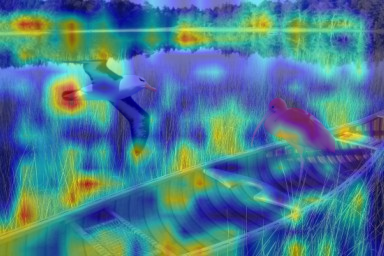

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




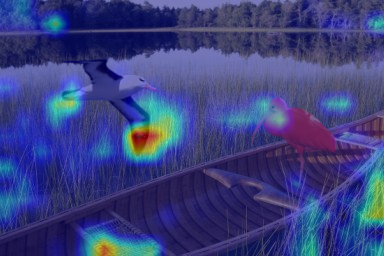

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




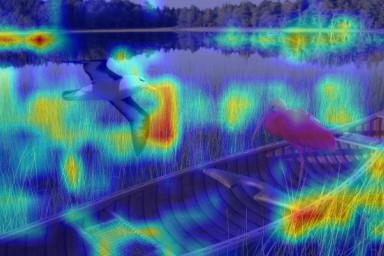

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




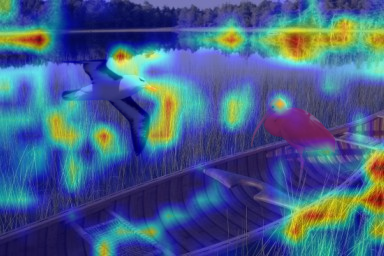

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




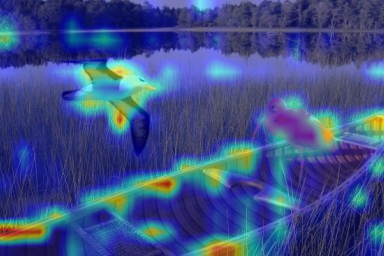

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




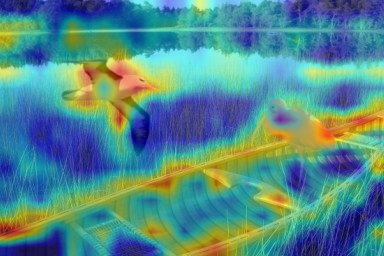

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




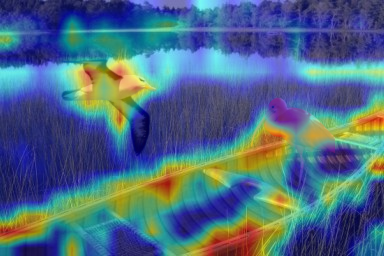

[Conv2d(384, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




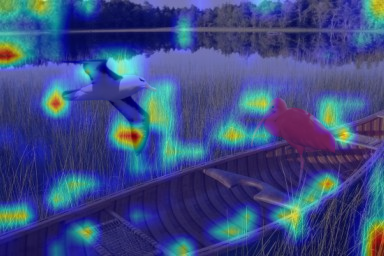

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




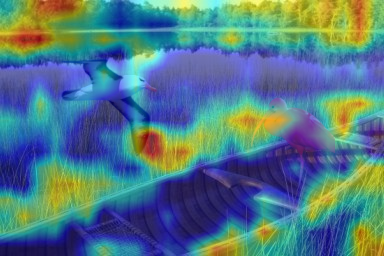

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




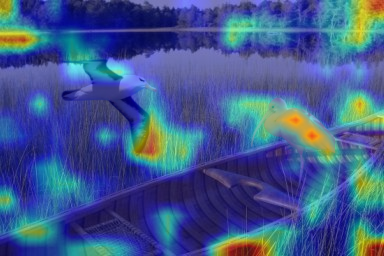

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




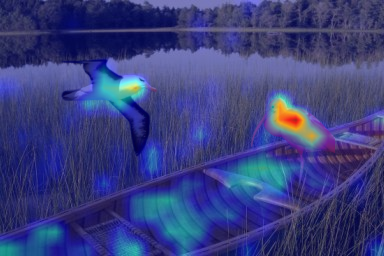

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




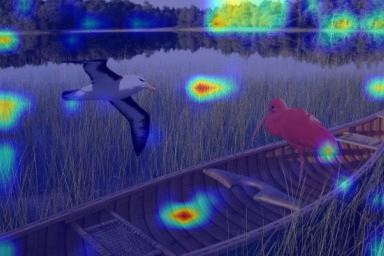

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




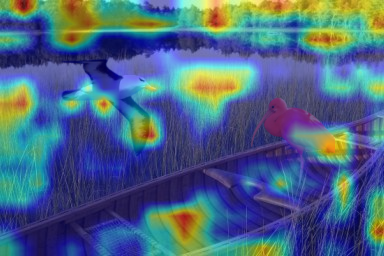

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




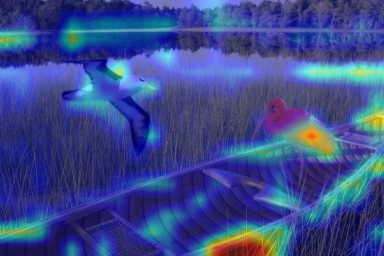

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




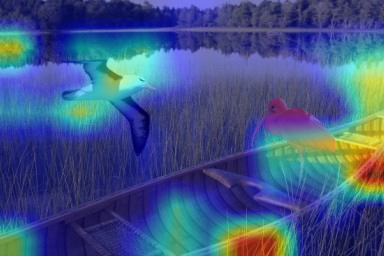

[Conv2d(576, 576, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=576, bias=False)]




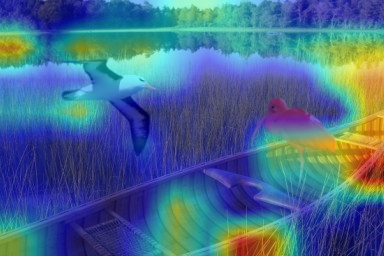

[Conv2d(576, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




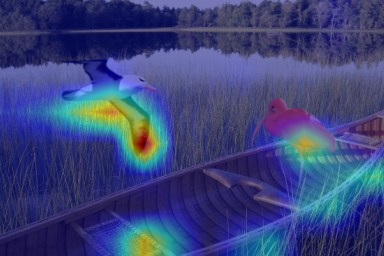

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




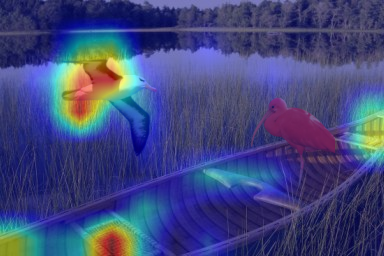

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




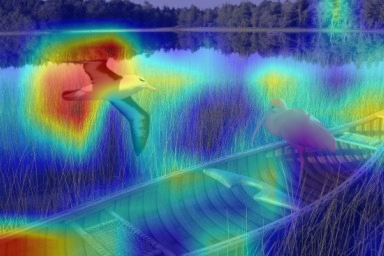

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




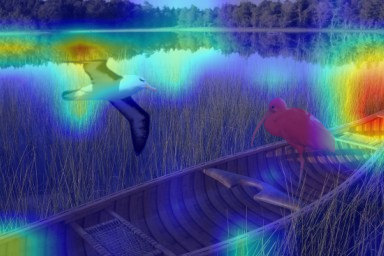

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




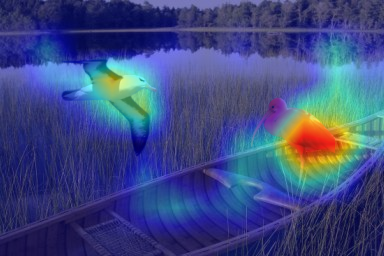

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




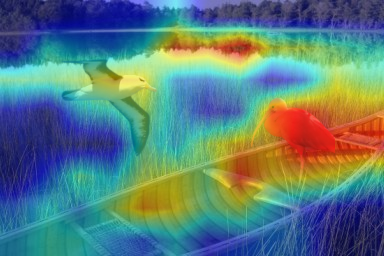

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




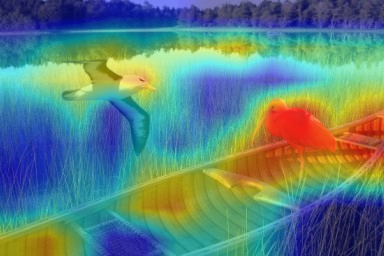

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




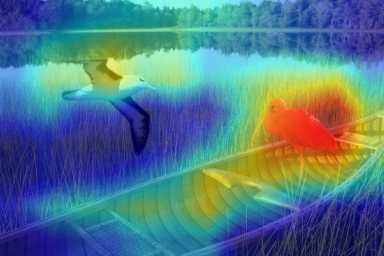

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




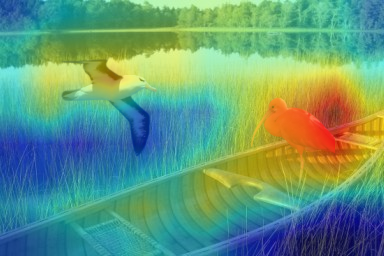

[Conv2d(960, 320, kernel_size=(1, 1), stride=(1, 1), bias=False)]




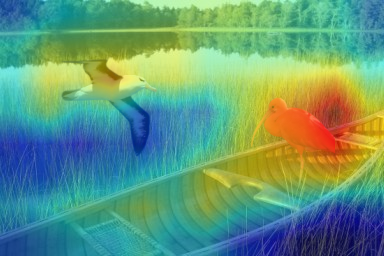

[Conv2d(320, 1280, kernel_size=(1, 1), stride=(1, 1), bias=False)]




In [ ]:
cam_algorithm = methods['gradcam'] 
for k in range(0,52):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")

### GRAD CAM ++ OUTPUT

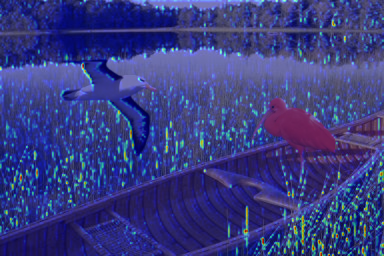

[Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)]




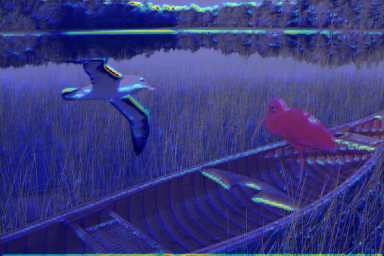

[Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)]




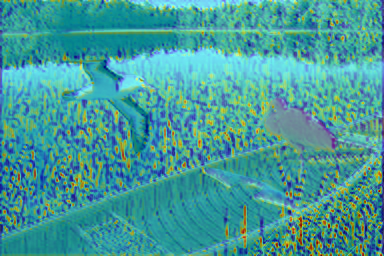

[Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)]




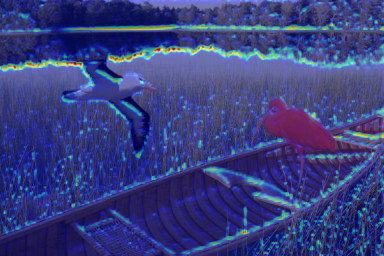

[Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




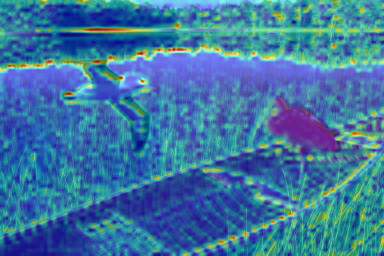

[Conv2d(96, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=96, bias=False)]




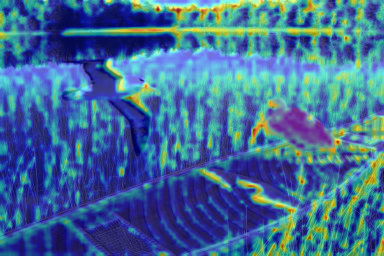

[Conv2d(96, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




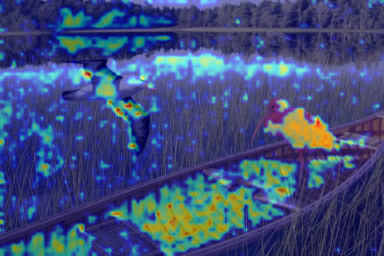

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




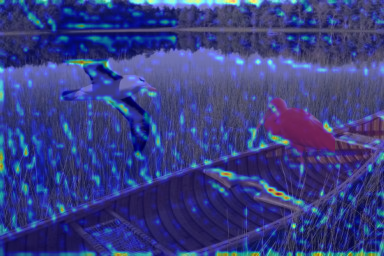

[Conv2d(144, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=144, bias=False)]




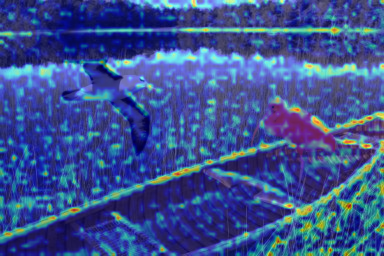

[Conv2d(144, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




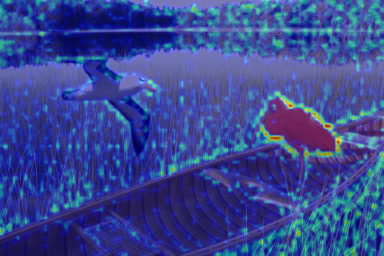

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




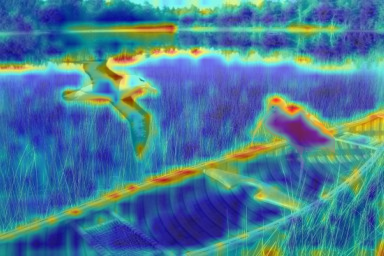

[Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=144, bias=False)]




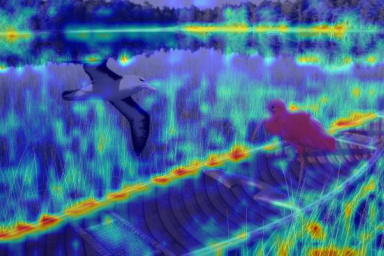

[Conv2d(144, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




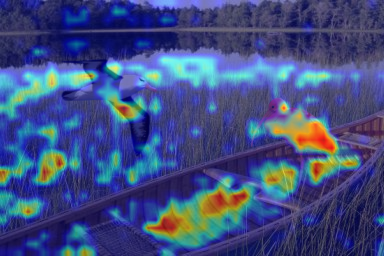

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




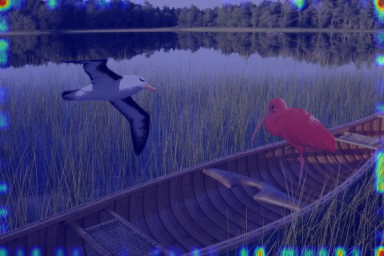

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




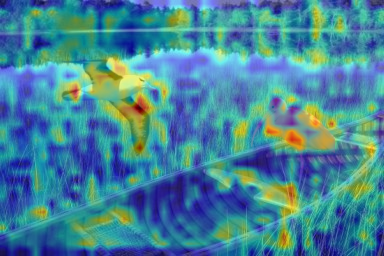

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




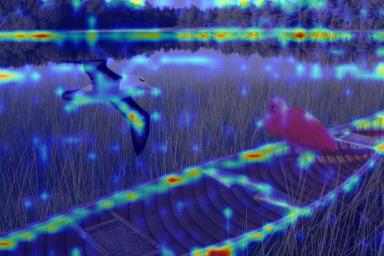

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




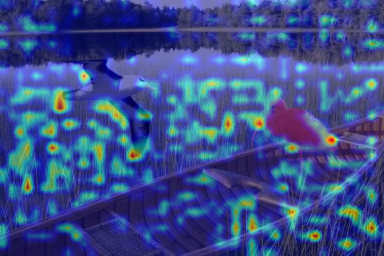

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




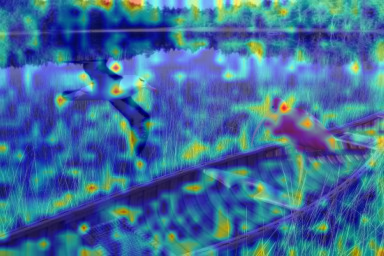

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




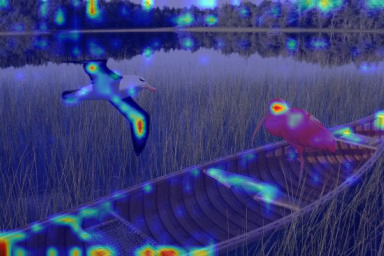

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




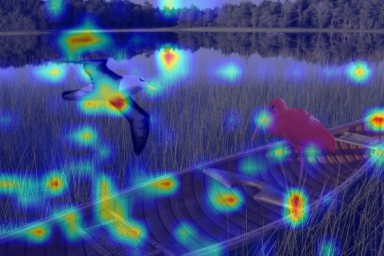

[Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=192, bias=False)]




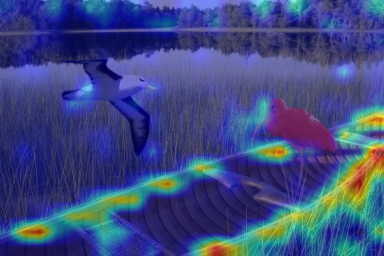

[Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




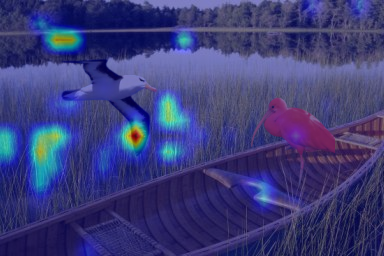

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




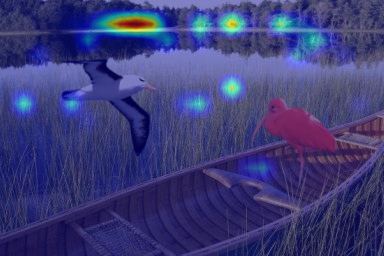

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




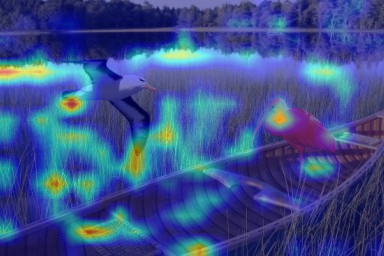

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




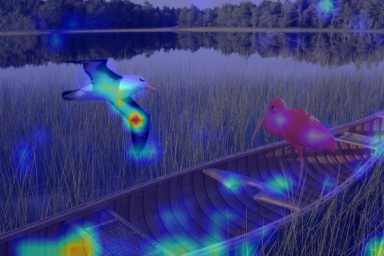

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




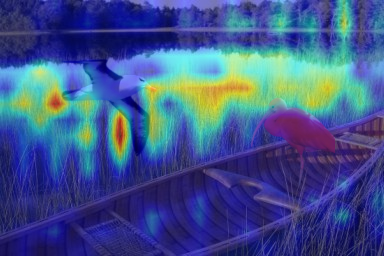

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




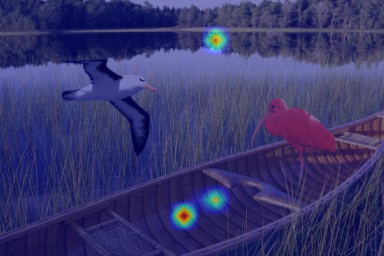

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




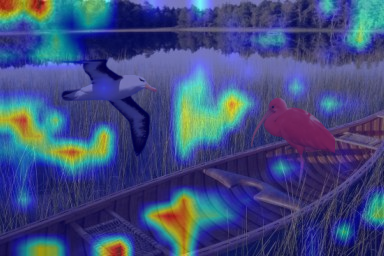

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




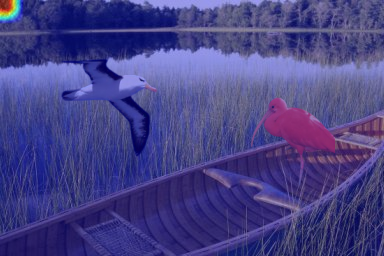

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




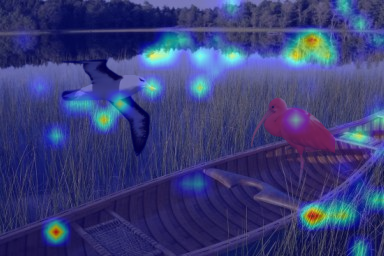

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




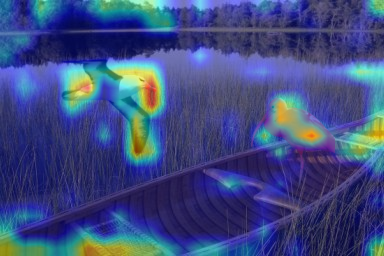

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




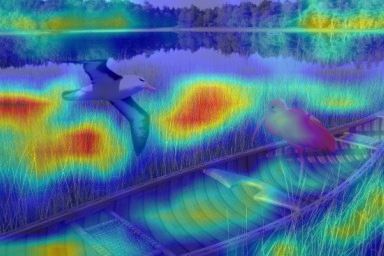

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




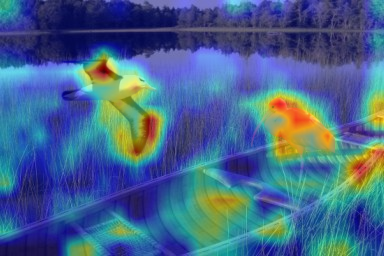

[Conv2d(384, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




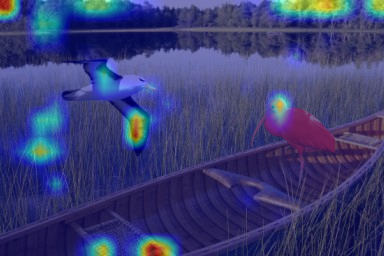

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




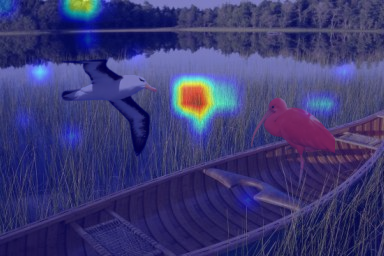

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




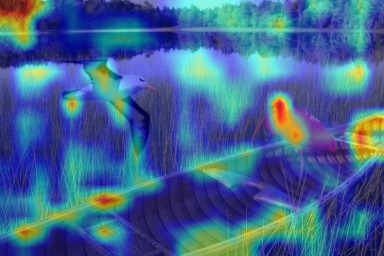

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




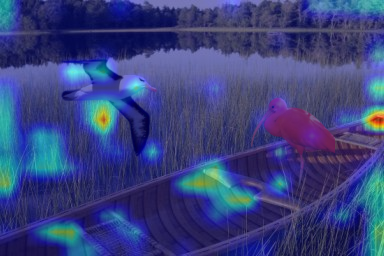

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




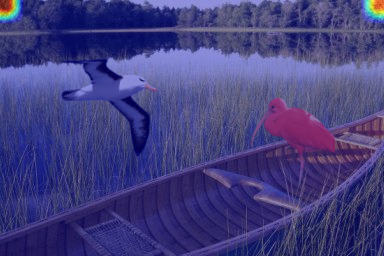

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




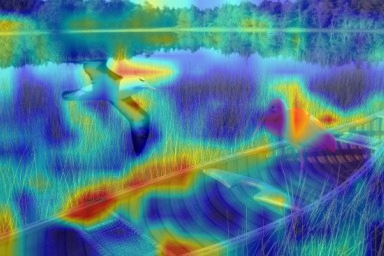

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




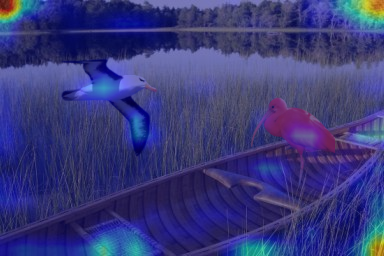

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




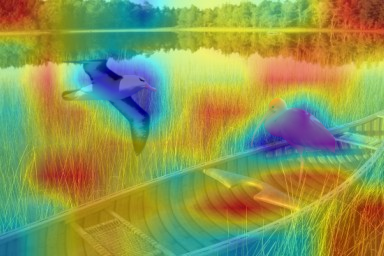

[Conv2d(576, 576, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=576, bias=False)]




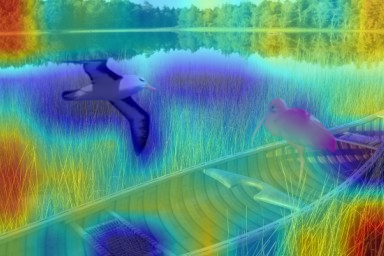

[Conv2d(576, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




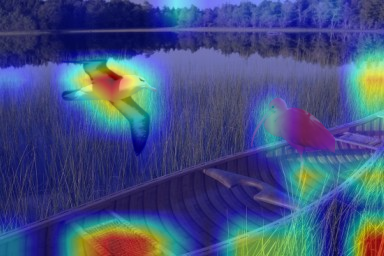

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




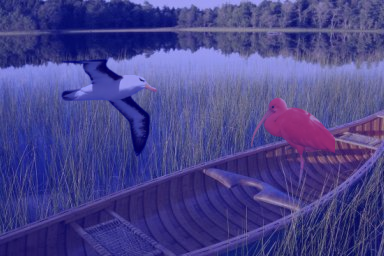

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




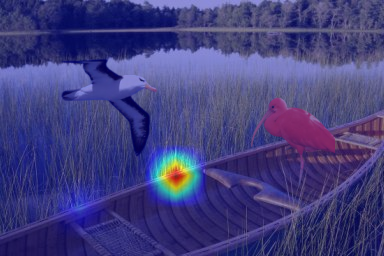

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




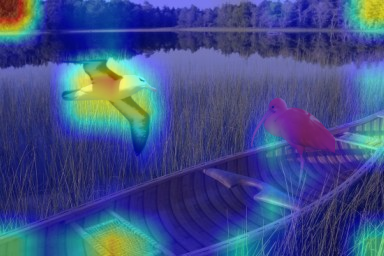

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




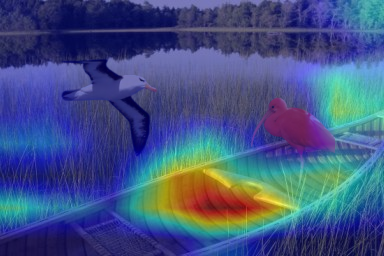

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




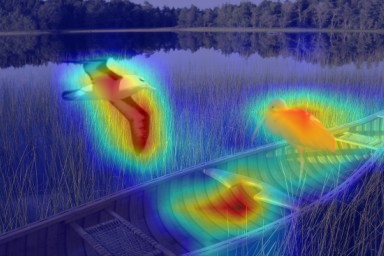

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




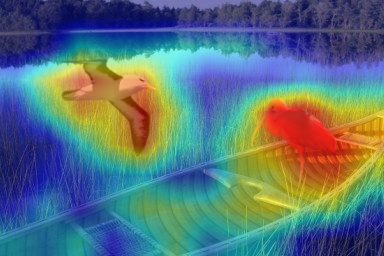

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




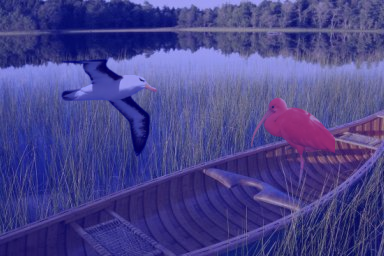

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




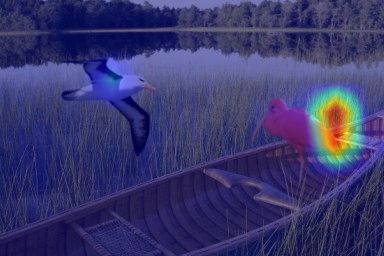

[Conv2d(960, 320, kernel_size=(1, 1), stride=(1, 1), bias=False)]




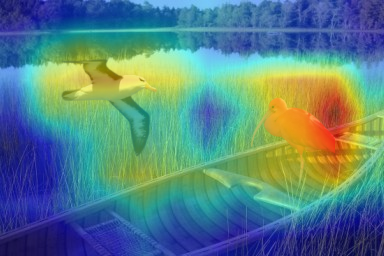

[Conv2d(320, 1280, kernel_size=(1, 1), stride=(1, 1), bias=False)]




In [ ]:
cam_algorithm = methods['gradcam++'] 
for k in range(0,52):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")

### ABLATION CAM OUTPUT

100%|██████████| 1/1 [00:05<00:00,  5.88s/it]


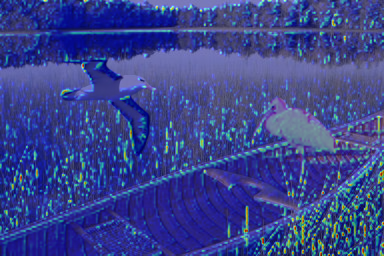

[Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)]




100%|██████████| 1/1 [00:04<00:00,  4.48s/it]


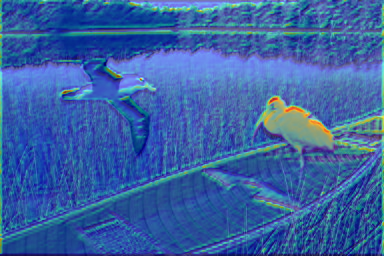

[Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)]




100%|██████████| 1/1 [00:02<00:00,  2.64s/it]


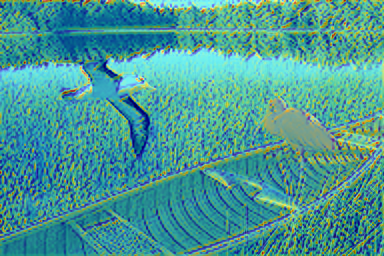

[Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 3/3 [00:20<00:00,  6.83s/it]


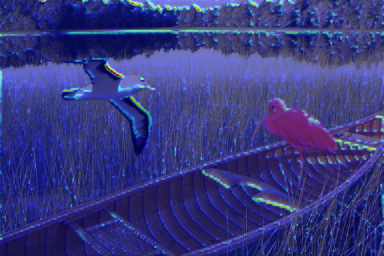

[Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 3/3 [00:13<00:00,  4.62s/it]


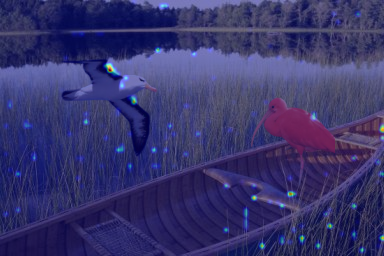

[Conv2d(96, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=96, bias=False)]




100%|██████████| 1/1 [00:03<00:00,  3.60s/it]


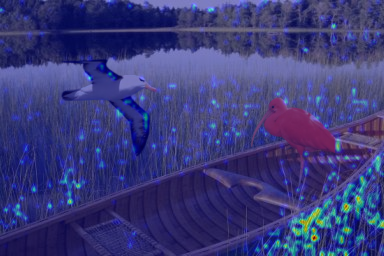

[Conv2d(96, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 5/5 [00:22<00:00,  4.41s/it]


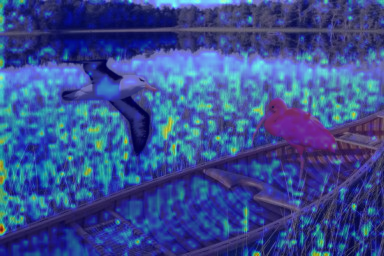

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 5/5 [00:22<00:00,  4.52s/it]


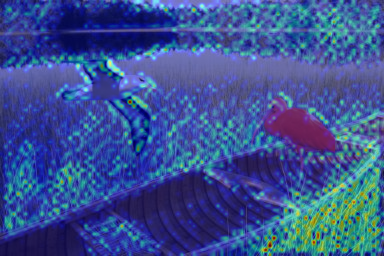

[Conv2d(144, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=144, bias=False)]




100%|██████████| 1/1 [00:02<00:00,  2.95s/it]


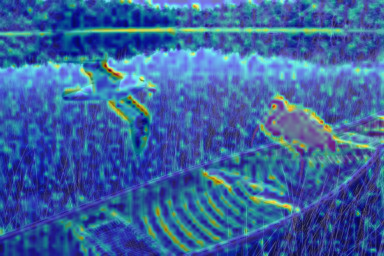

[Conv2d(144, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 5/5 [00:24<00:00,  4.81s/it]


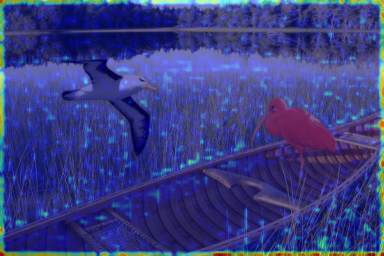

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 5/5 [00:18<00:00,  3.74s/it]


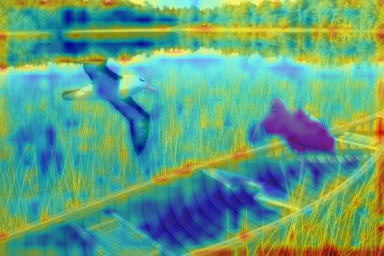

[Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=144, bias=False)]




100%|██████████| 1/1 [00:04<00:00,  4.15s/it]


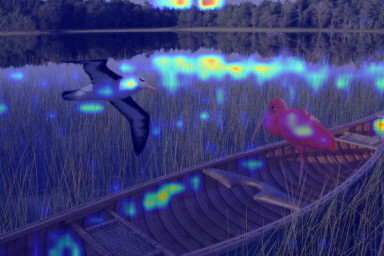

[Conv2d(144, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:25<00:00,  4.25s/it]


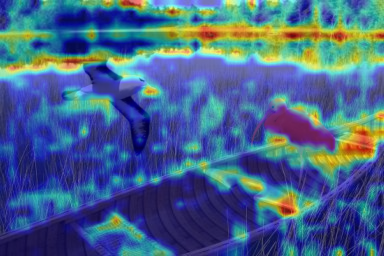

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:27<00:00,  4.67s/it]


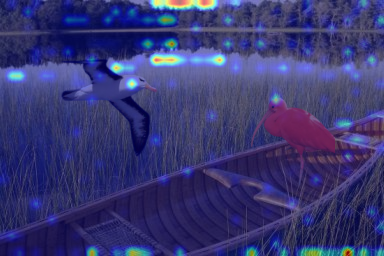

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




100%|██████████| 1/1 [00:04<00:00,  4.27s/it]


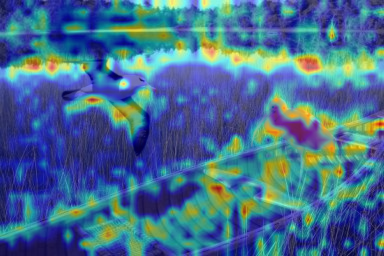

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:26<00:00,  4.43s/it]


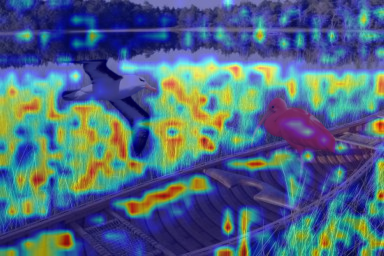

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:26<00:00,  4.41s/it]


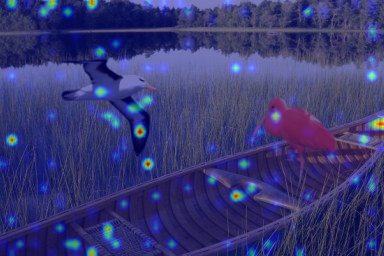

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




100%|██████████| 1/1 [00:04<00:00,  4.34s/it]


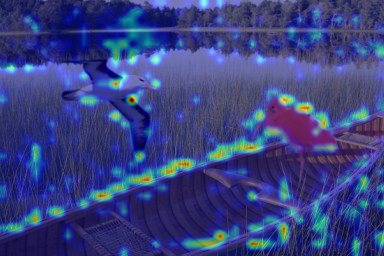

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:26<00:00,  4.43s/it]


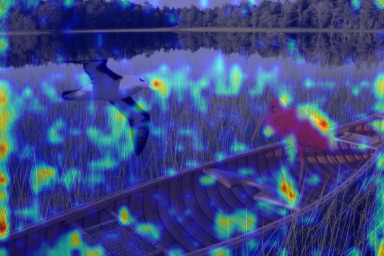

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 6/6 [00:26<00:00,  4.36s/it]


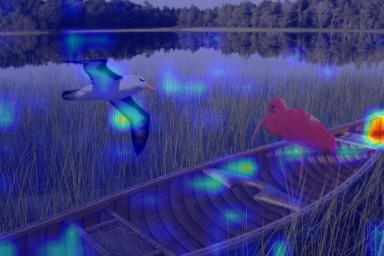

[Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=192, bias=False)]




100%|██████████| 2/2 [00:08<00:00,  4.33s/it]


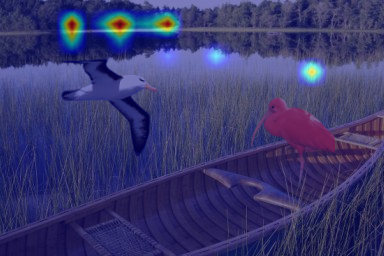

[Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:52<00:00,  4.34s/it]


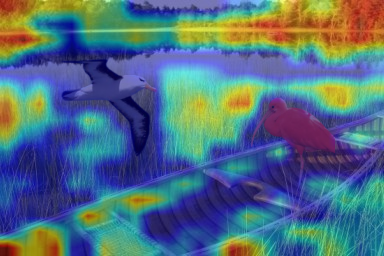

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:52<00:00,  4.35s/it]


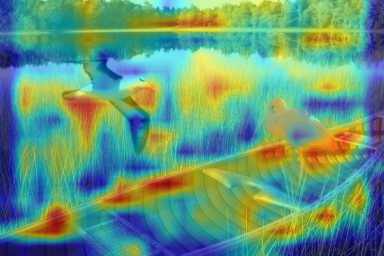

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




100%|██████████| 2/2 [00:08<00:00,  4.27s/it]


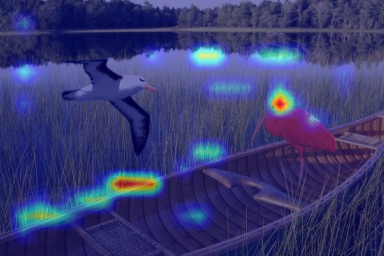

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:51<00:00,  4.30s/it]


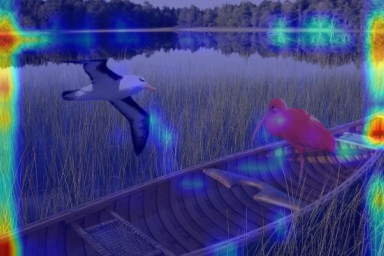

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:52<00:00,  4.36s/it]


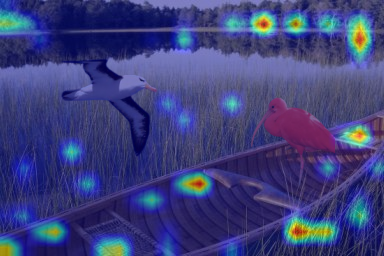

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




100%|██████████| 2/2 [00:08<00:00,  4.29s/it]


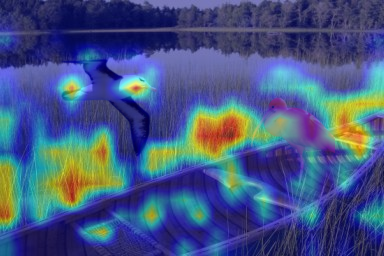

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:52<00:00,  4.34s/it]


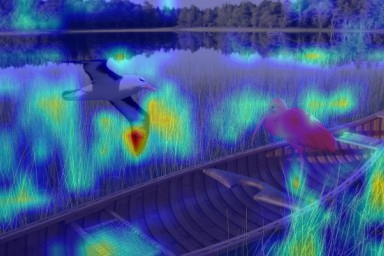

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:51<00:00,  4.31s/it]


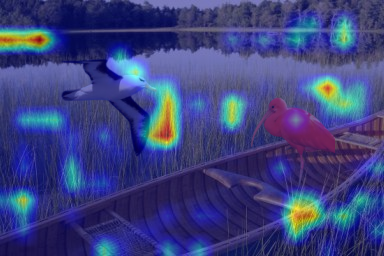

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




100%|██████████| 2/2 [00:08<00:00,  4.28s/it]


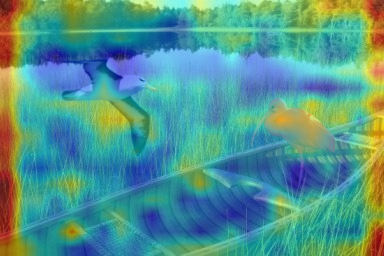

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:52<00:00,  4.38s/it]


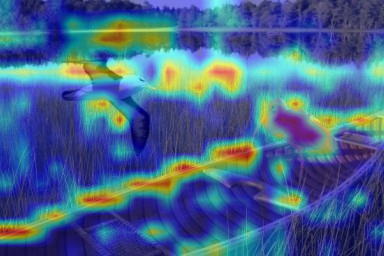

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 12/12 [00:51<00:00,  4.30s/it]


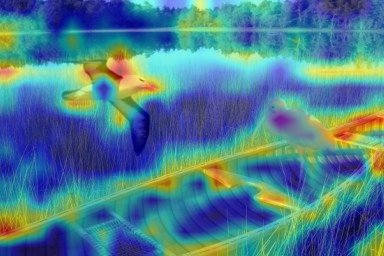

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




100%|██████████| 3/3 [00:12<00:00,  4.30s/it]


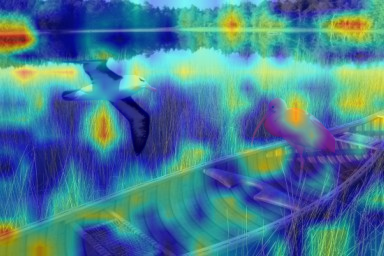

[Conv2d(384, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:18<00:00,  4.36s/it]


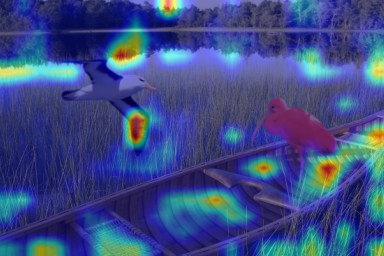

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:18<00:00,  4.34s/it]


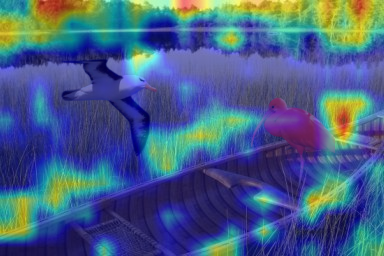

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




100%|██████████| 3/3 [00:12<00:00,  4.27s/it]


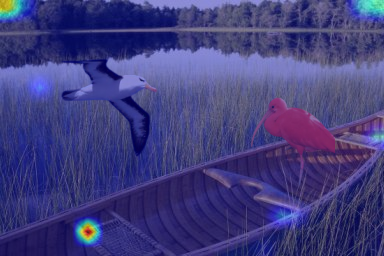

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:19<00:00,  4.43s/it]


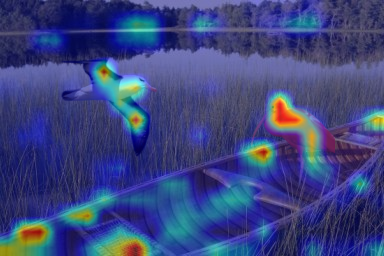

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:18<00:00,  4.38s/it]


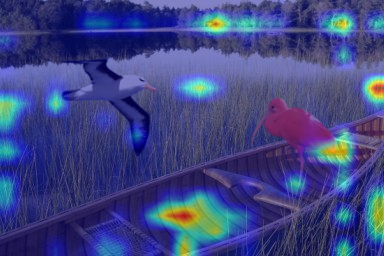

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




100%|██████████| 3/3 [00:12<00:00,  4.19s/it]


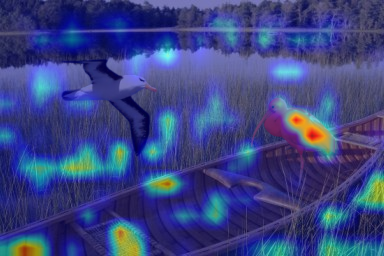

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:17<00:00,  4.32s/it]


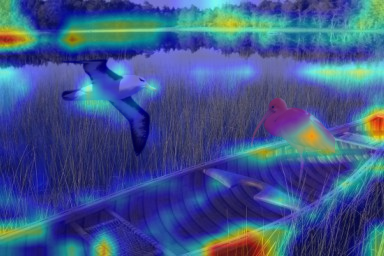

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 18/18 [01:16<00:00,  4.26s/it]


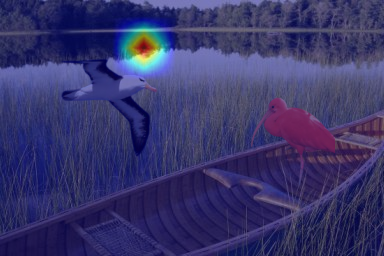

[Conv2d(576, 576, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=576, bias=False)]




100%|██████████| 5/5 [00:21<00:00,  4.22s/it]


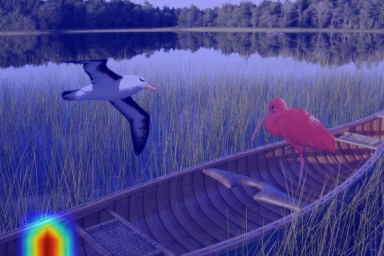

[Conv2d(576, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:10<00:00,  4.35s/it]


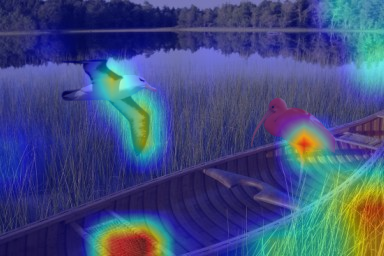

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:11<00:00,  4.38s/it]


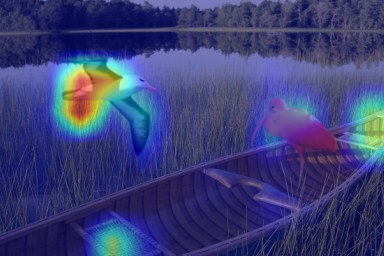

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




100%|██████████| 5/5 [00:21<00:00,  4.28s/it]


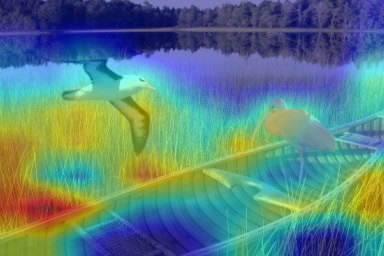

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:10<00:00,  4.36s/it]


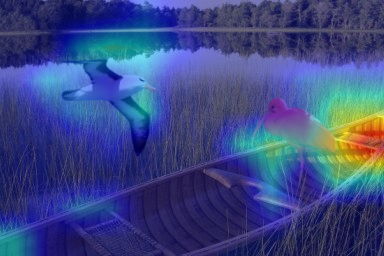

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:14<00:00,  4.49s/it]


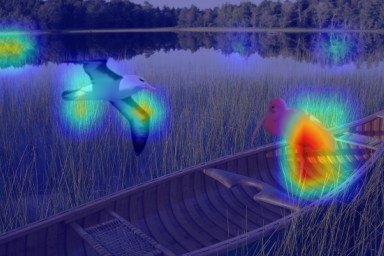

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




100%|██████████| 5/5 [00:22<00:00,  4.58s/it]


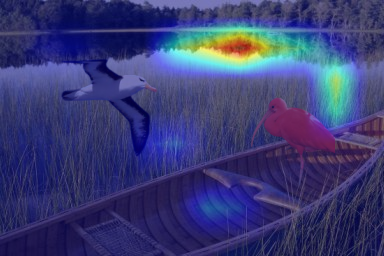

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:21<00:00,  4.73s/it]


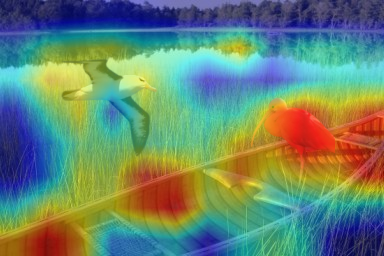

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 30/30 [02:23<00:00,  4.78s/it]


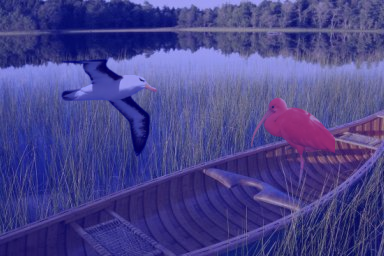

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




100%|██████████| 10/10 [00:47<00:00,  4.77s/it]


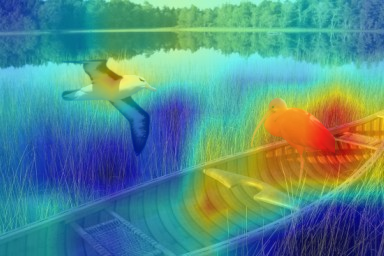

[Conv2d(960, 320, kernel_size=(1, 1), stride=(1, 1), bias=False)]




100%|██████████| 40/40 [03:07<00:00,  4.68s/it]


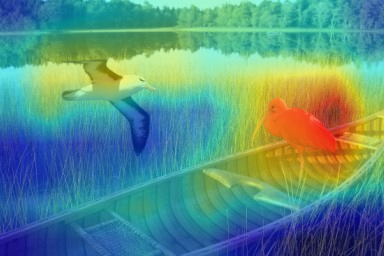

[Conv2d(320, 1280, kernel_size=(1, 1), stride=(1, 1), bias=False)]




In [ ]:
cam_algorithm = methods['ablationcam'] 
for k in range(0,52):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")

### EIGEN CAM OUTPUT
Note: We are running 5 layers in a cell for better resource utilization purpose to avoid session crash only

In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(6):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(6,11):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")



In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(11,16):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(16,21):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(21,26):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(26,31):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(31,36):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(36,41):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(41,46):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


In [ ]:
cam_algorithm = methods['eigencam'] 
for k in range(46,52):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")


### LAYER CAM OUTPUT

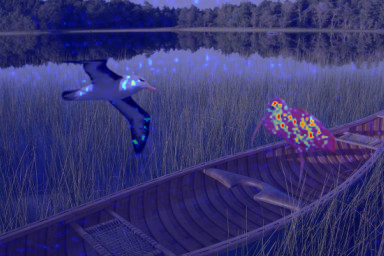

[Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)]




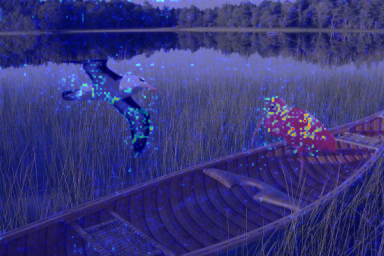

[Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)]




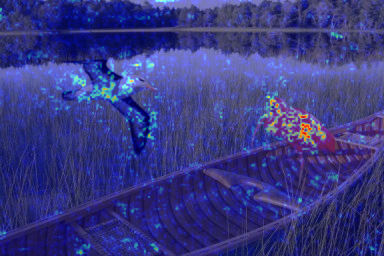

[Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)]




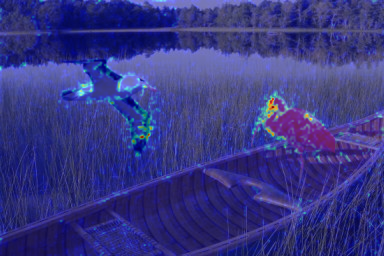

[Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




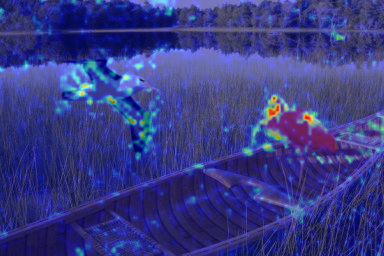

[Conv2d(96, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=96, bias=False)]




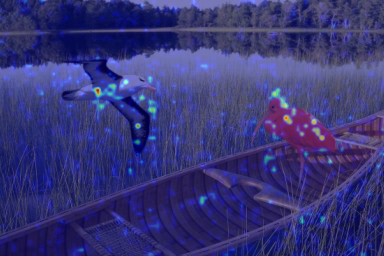

[Conv2d(96, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




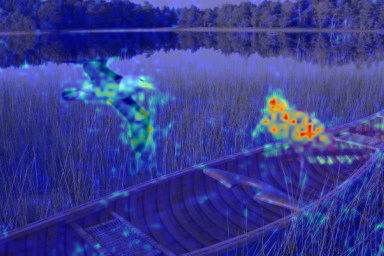

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




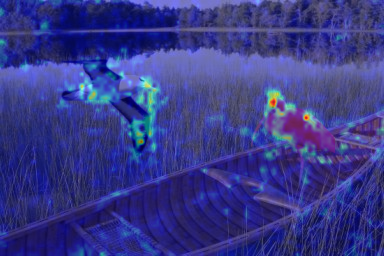

[Conv2d(144, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=144, bias=False)]




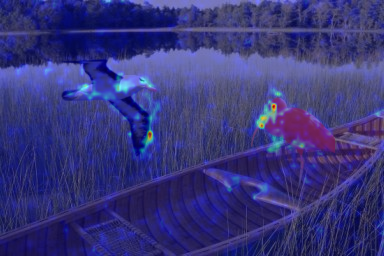

[Conv2d(144, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)]




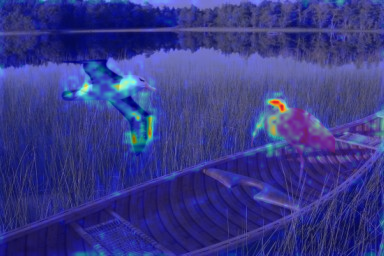

[Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)]




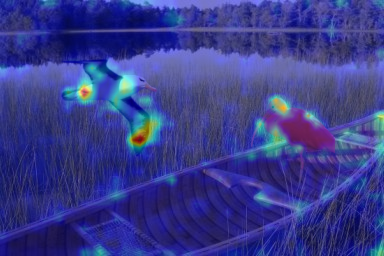

[Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=144, bias=False)]




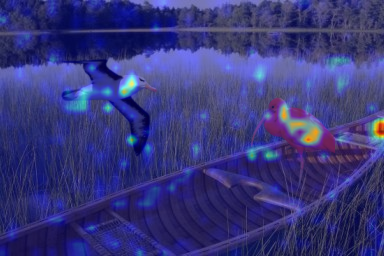

[Conv2d(144, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




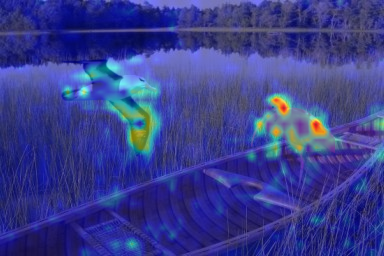

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




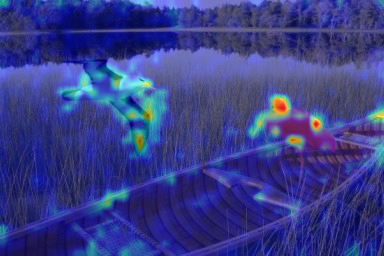

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




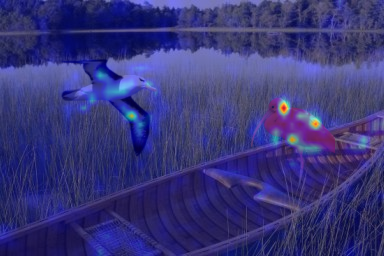

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




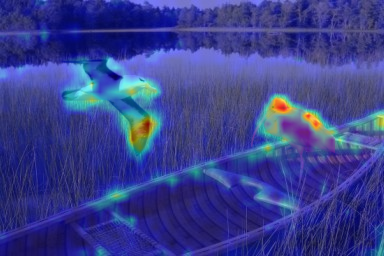

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




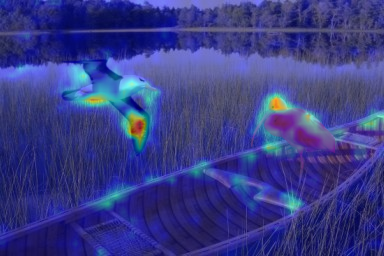

[Conv2d(192, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=192, bias=False)]




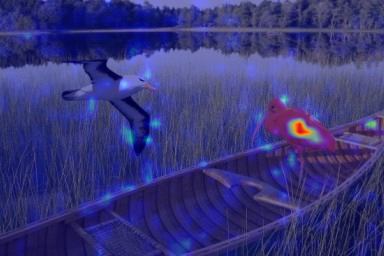

[Conv2d(192, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)]




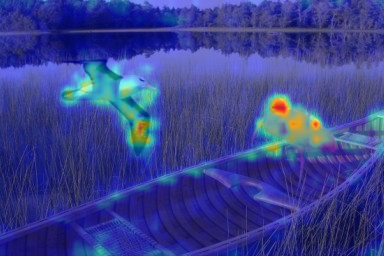

[Conv2d(32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)]




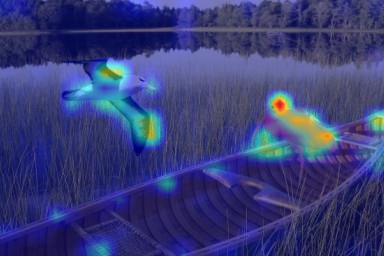

[Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=192, bias=False)]




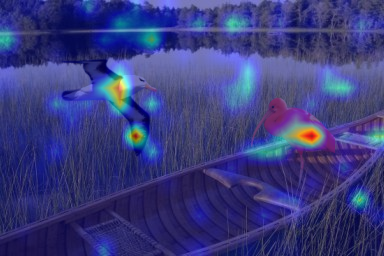

[Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




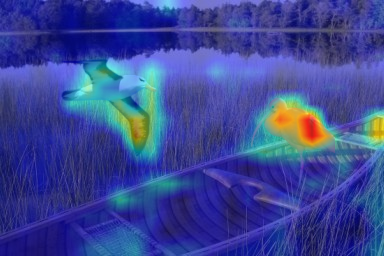

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




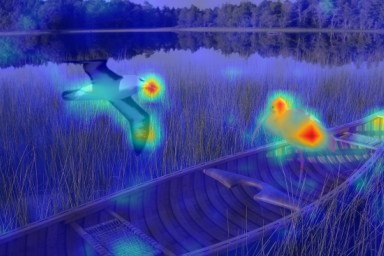

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




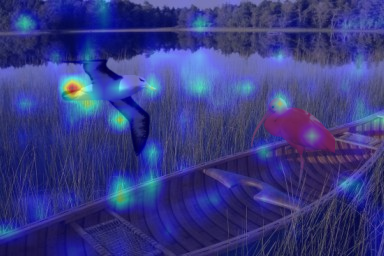

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




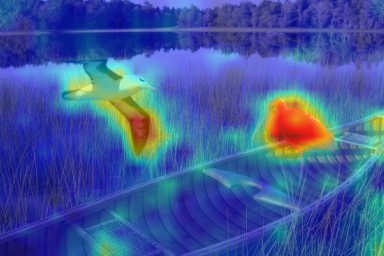

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




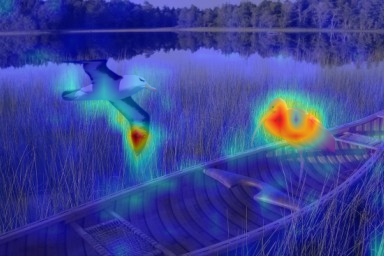

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




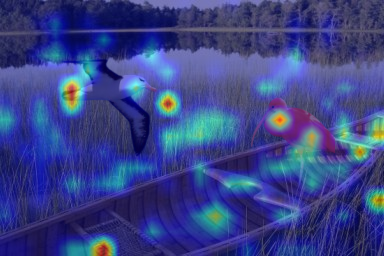

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




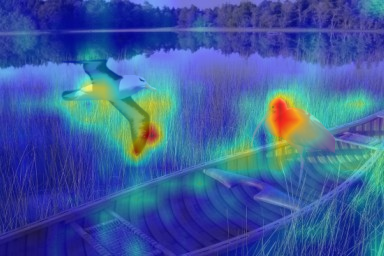

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




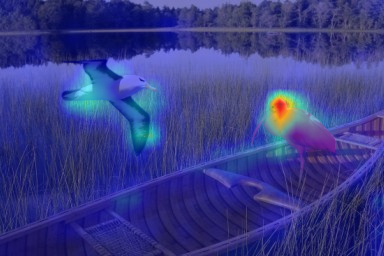

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




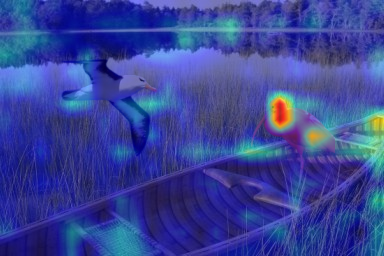

[Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)]




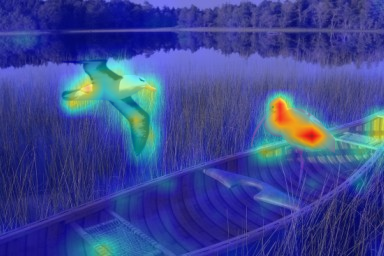

[Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)]




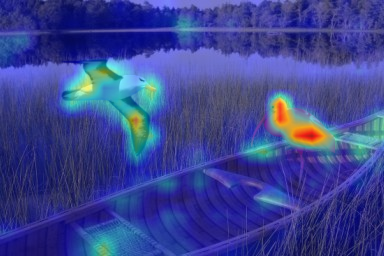

[Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)]




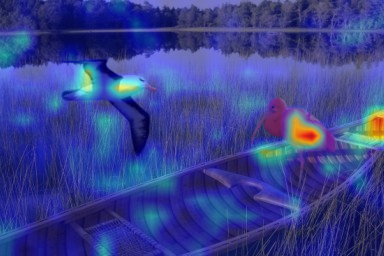

[Conv2d(384, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




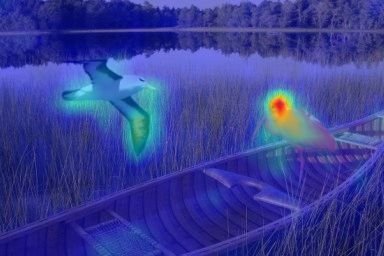

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




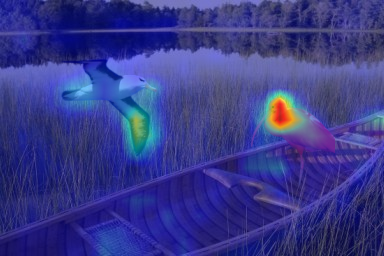

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




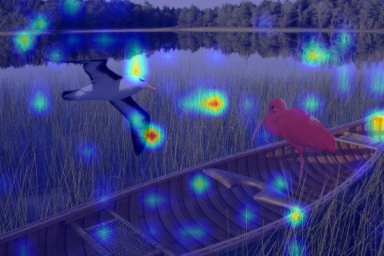

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




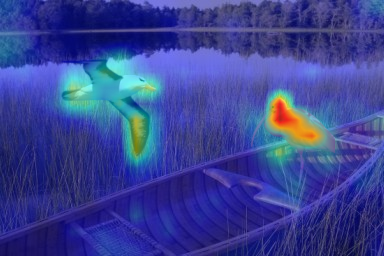

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




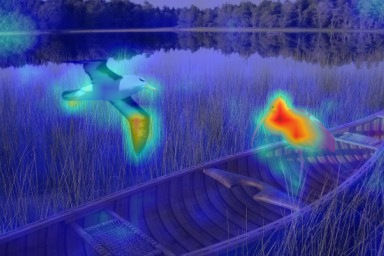

[Conv2d(576, 576, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=576, bias=False)]




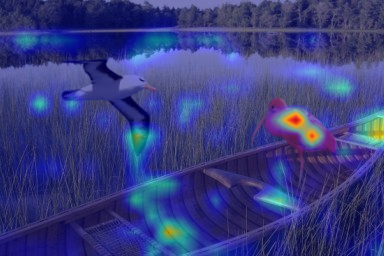

[Conv2d(576, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)]




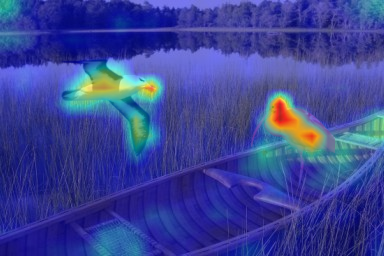

[Conv2d(96, 576, kernel_size=(1, 1), stride=(1, 1), bias=False)]




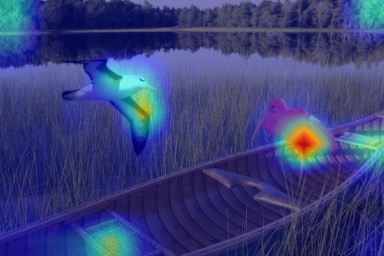

[Conv2d(576, 576, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=576, bias=False)]




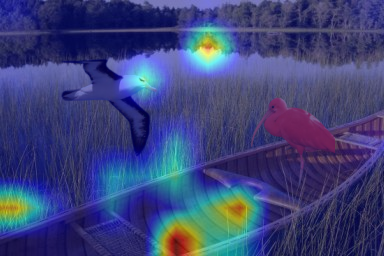

[Conv2d(576, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




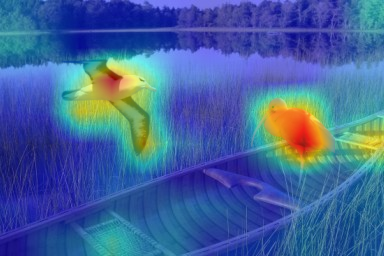

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




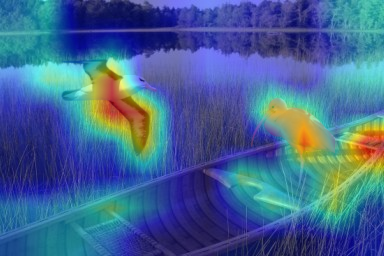

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




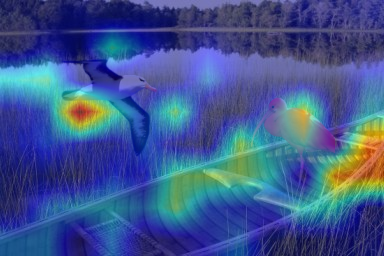

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




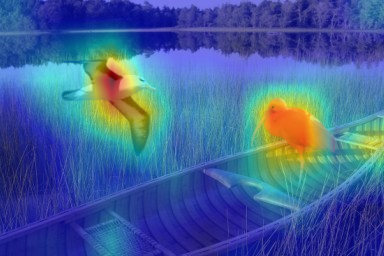

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




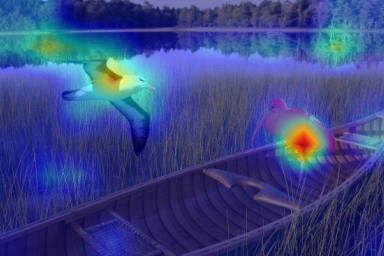

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




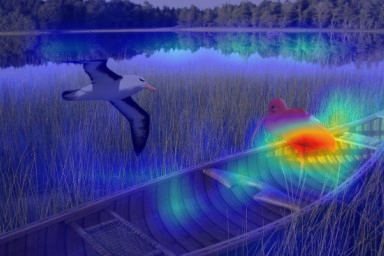

[Conv2d(960, 160, kernel_size=(1, 1), stride=(1, 1), bias=False)]




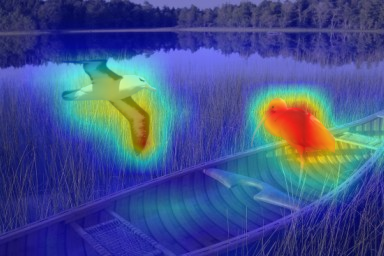

[Conv2d(160, 960, kernel_size=(1, 1), stride=(1, 1), bias=False)]




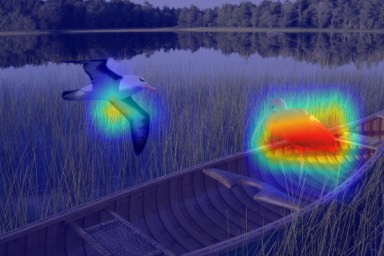

[Conv2d(960, 960, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=960, bias=False)]




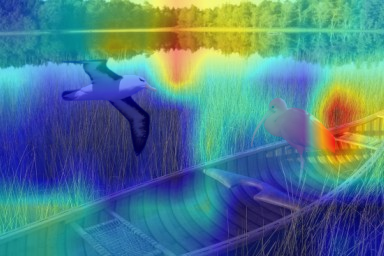

[Conv2d(960, 320, kernel_size=(1, 1), stride=(1, 1), bias=False)]




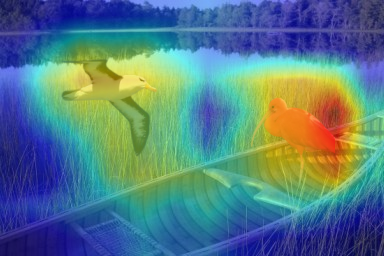

[Conv2d(320, 1280, kernel_size=(1, 1), stride=(1, 1), bias=False)]




In [ ]:
cam_algorithm = methods['layercam'] 
for k in range(0,52):
  layerName = [target_layers[k]]
  
  cam=cam_algorithm(model=the_model,
                       target_layers=layerName,
                       )
  grayscale_cam = cam(input_tensor=input_tensor,
                            targets=targets,
                      )
  grayscale_cam = grayscale_cam[0, :]

  cam_image = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  cam_image = cv2.cvtColor(cam_image, cv2.COLOR_RGB2BGR)
  
  cv2_imshow(cam_image)
  print(layerName)
  print("\n")
